# Project Proposal

This project will use an image dataset to train a model to classify food images. The dataset contains images of food items and their labels. The model will be trained to classify the images based on the labels.

In [25]:
# import statements
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from skimage.io import imread
from skimage.transform import resize
from skimage.feature import hog
from skimage.transform import rescale

### Code to read data

In [ ]:
# read the jpg files
categories = [
    'training/Bread',
    'training/Dairy product',
    'training/Dessert',
    'training/Egg',
    'training/Fried food',
    'training/Meat',
    'training/Noodles-Pasta',
    'training/Rice',
    'training/Seafood',
    'training/Soup',
    'training/Vegetable-Fruit',
]

images = []
# read all the jpg files in the directories 
# and store them in the images list
for category in categories:
    print('reading files in {}'.format(category))
    for img in os.listdir(category):  
        im = imread(category + '/' + img)
        im = resize(im, (224, 224))
        images.append(im)
        
print(images)

reading files in training/Bread


/Users/davidkhachatryan/.pyenv/versions/3.7.10/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:811: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/Users/davidkhachatryan/.pyenv/versions/3.7.10/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:811: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 0. 
  warnings.warn(str(msg))
/Users/davidkhachatryan/.pyenv/versions/3.7.10/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:811: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 3. 
  warnings.warn(str(msg))


reading files in training/Dairy product
reading files in training/Dessert
reading files in training/Egg


/Users/davidkhachatryan/.pyenv/versions/3.7.10/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:811: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 11. 
  warnings.warn(str(msg))


reading files in training/Fried food
reading files in training/Meat
reading files in training/Noodles-Pasta
reading files in training/Rice


/Users/davidkhachatryan/.pyenv/versions/3.7.10/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:811: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))


reading files in training/Seafood
reading files in training/Soup
reading files in training/Vegetable-Fruit
[array([[[0.47510504, 0.391767  , 0.27019841],
        [0.47780423, 0.39446619, 0.27289759],
        [0.47001449, 0.38667645, 0.26510785],
        ...,
        [0.20743322, 0.22750093, 0.27352174],
        [0.19708402, 0.22489556, 0.25754757],
        [0.17648769, 0.2278649 , 0.25738541]],

       [[0.47754159, 0.38610201, 0.26522623],
        [0.48395569, 0.3925161 , 0.27164033],
        [0.4871999 , 0.39576031, 0.27488454],
        ...,
        [0.1953817 , 0.22663352, 0.27062155],
        [0.18921365, 0.2235194 , 0.26059124],
        [0.17515973, 0.21812802, 0.26219116]],

       [[0.48214389, 0.38378557, 0.26629806],
        [0.47883283, 0.38047451, 0.26298701],
        [0.48681179, 0.38845347, 0.27096596],
        ...,
        [0.18277265, 0.23010679, 0.27475292],
        [0.18891717, 0.22319503, 0.27178895],
        [0.19020518, 0.21922121, 0.28039519]],

       ...,

      

image rescaled
image hogged
number of pixels:  12544
number of hog features:  112


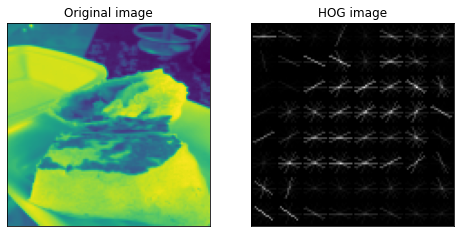

image rescaled
image hogged
number of pixels:  12544
number of hog features:  112


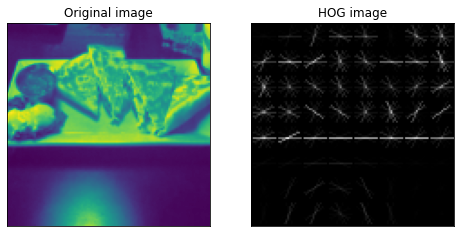

image rescaled
image hogged
number of pixels:  12544
number of hog features:  112


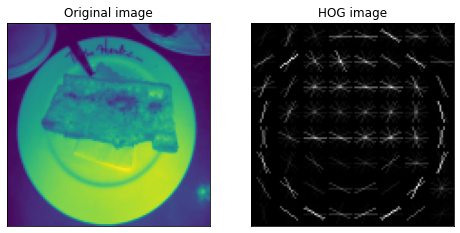

In [54]:
# reduce processed data points to a smaller number

def hog_image(image):
    first_image = rescale(image, scale=0.5, mode='reflect')
    
    print('image rescaled')
    first_image_hog, first_image_hog_img = hog(
        first_image, pixels_per_cell=(14,14), 
        cells_per_block=(2, 2), 
        orientations=9, 
        visualize=True, 
        channel_axis=2)
        
    print('image hogged')
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    fig.set_size_inches(8, 4)
    
    [a.tick_params(bottom=False, left=False, labelbottom=False, labelleft=False) 
        for a in ax]
    
    print('number of pixels: ', first_image.shape[0] * first_image.shape[1])
    print('number of hog features: ', first_image.shape[0])


    ax[0].imshow(first_image[:,:,0], cmap='viridis')
    ax[0].set_title('Original image')
    ax[1].imshow(first_image_hog_img, cmap=plt.cm.gray)
    ax[1].set_title('HOG image')
    plt.show()

# loop through the images 10 times
for i in range(3):
    hog_image(images[i])

### Description of the question(s)

### Variable(s) and method(s)

We will be using Grid Search to find the best parameters for our model. The grid search will perform an SVMs with different kernels and different values of C. We will benchmark the performance against Stochastic Gradient Descent.